In [1]:

import plot_functions

In [2]:
import numpy as np
import matplotlib.pyplot as plt
import mpl_toolkits.mplot3d.axes3d as p3
import matplotlib.animation as animation

In [3]:
import traj_generator
import physics_sim_simple_moreparticles_proteins

import process_data

In [4]:
import numpy as np
import plotly.graph_objs as go

In [5]:
move_groups_nr = 3
particles_per_group = 100

explicit_groups = []
group_size = 10

curr_group = 0
while 1 == 1:
    for i in range(group_size):
        explicit_groups.append(curr_group%move_groups_nr)

        if len(explicit_groups) == particles_per_group:
            break
    if len(explicit_groups) == particles_per_group:
        break
    curr_group = curr_group + 1


In [6]:
explicit_groups

[0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0]

In [7]:
particles_from_sim = physics_sim_simple_moreparticles_proteins.simulate_for_clustering(stim_steps=1000, temp=[1,2,3], thermostat=1, entities=1, particles_per_group=100, group_thermostat=0, dt=0.01, harmpot=0, fenepot=1, desireddist = 1.04, pot_const=30, group_additions=True, friction=1, explicit_groups=explicit_groups)

In [8]:
trajectories = process_data.simulation_to_array(particles_from_sim)

In [9]:
plot_functions.plot_traj_labels_plotly_2nd(trajectories)

In [10]:
groups_list = np.array(trajectories)[:,:,-1]
num_groups = len(np.unique(np.array(groups_list).flatten()))

In [11]:
num_groups

3

In [12]:
%matplotlib notebook


a = plot_functions.plot_traj_labels_plt(trajectories, save_video=True, interval = 10)

<IPython.core.display.Javascript object>

In [13]:
a

In [14]:
plt.show()

In [15]:
from IPython.display import HTML
HTML(a.to_html5_video())

In [16]:
df = process_data.create_clustering_df(trajectories)

In [17]:
import redpandda_general
res_hdbscan = redpandda_general.main_clustering_general(df, None, clustering_algorithm="hdbscan")

0.0296


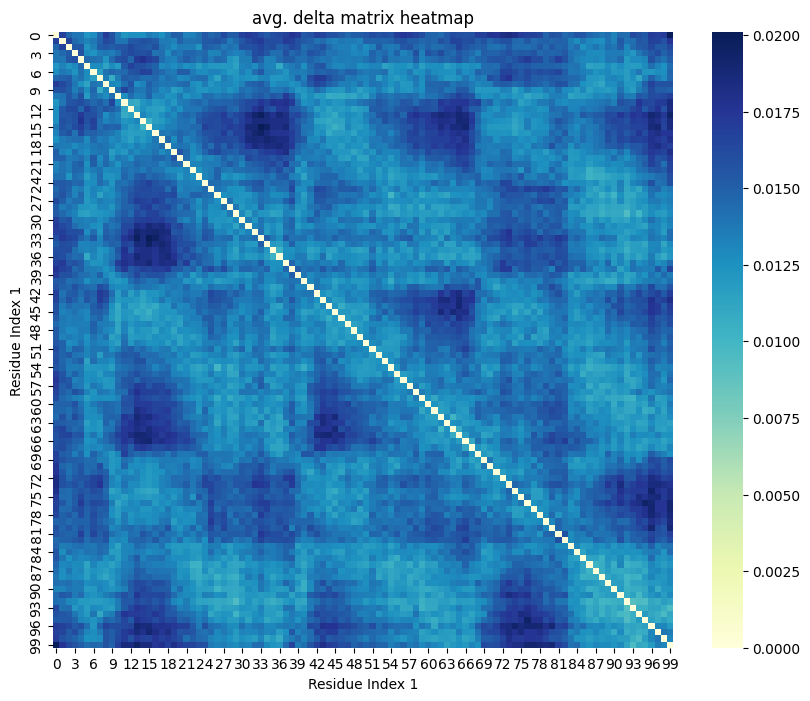

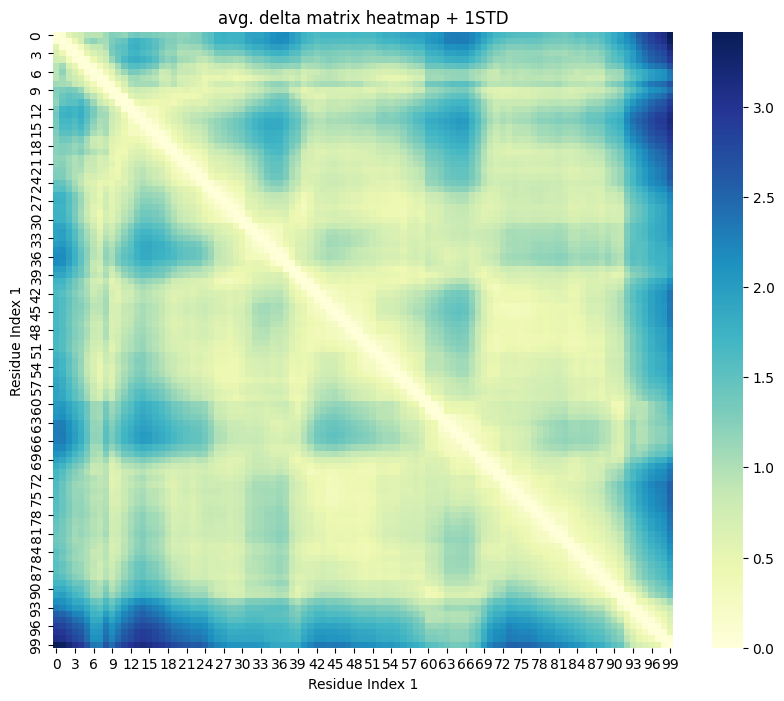

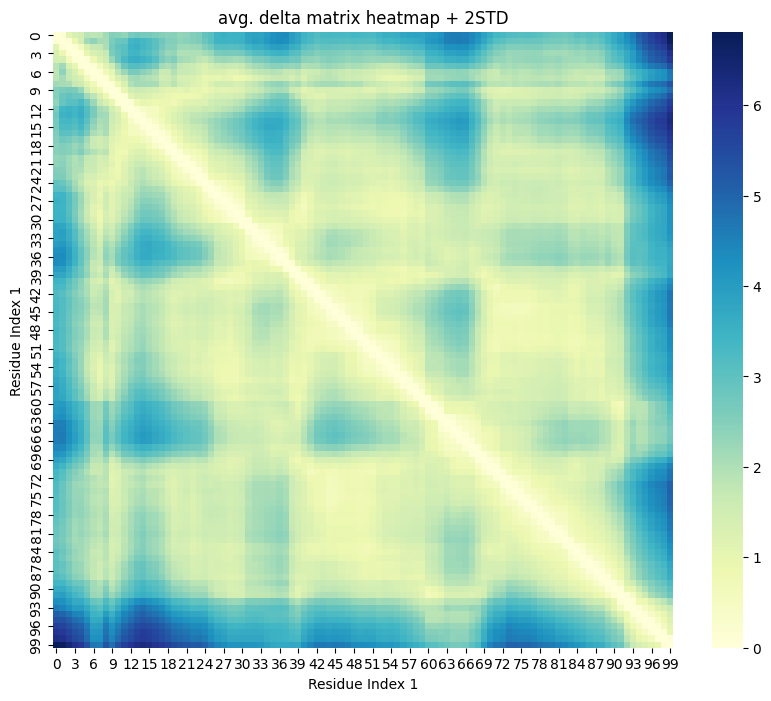

1.6928
something wrong with clustering Q computation


In [18]:
%matplotlib inline

res_hdbscan_2std = redpandda_general.main_clustering_general_std(df, None, clustering_algorithm="hdbscan")

In [19]:
res_hdbscan_2std

(array([-1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1,
        -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1,
        -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1,
        -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1,
        -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1,
        -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1]),
 [],
 array([[1.        , 0.98103645, 0.83839698, ..., 0.12345307, 0.09321821,
         0.        ],
        [0.98103645, 1.        , 0.98218675, ..., 0.13784193, 0.10800841,
         0.01617618],
        [0.83839698, 0.98218675, 1.        , ..., 0.17546751, 0.14764138,
         0.05947334],
        ...,
        [0.12345307, 0.13784193, 0.17546751, ..., 1.        , 0.98551824,
         0.85881941],
        [0.09321821, 0.10800841, 0.14764138, ..., 0.98551824, 1.        ,
         0.98589094],
        [0.        , 0.01617618, 0.05947334, ..., 0.

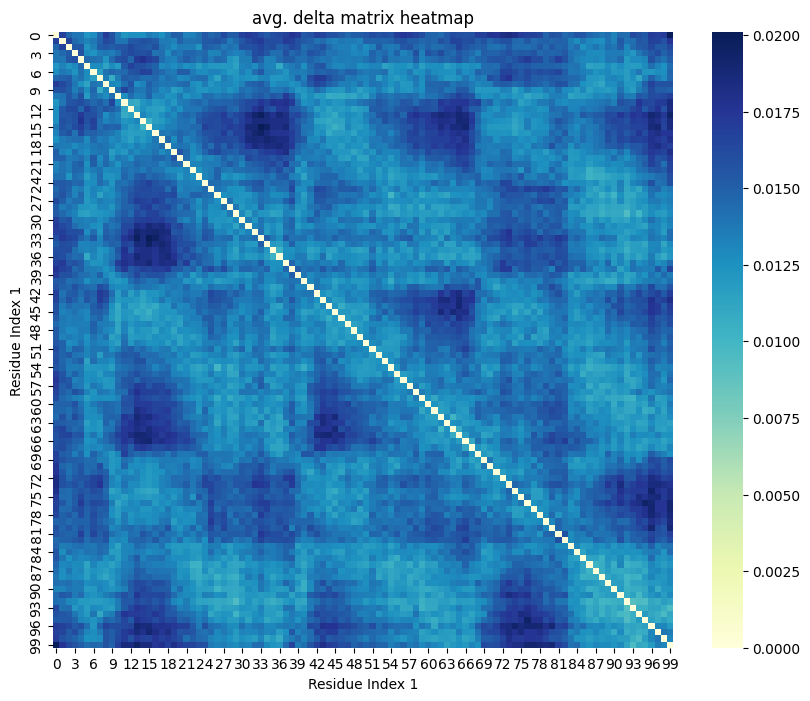

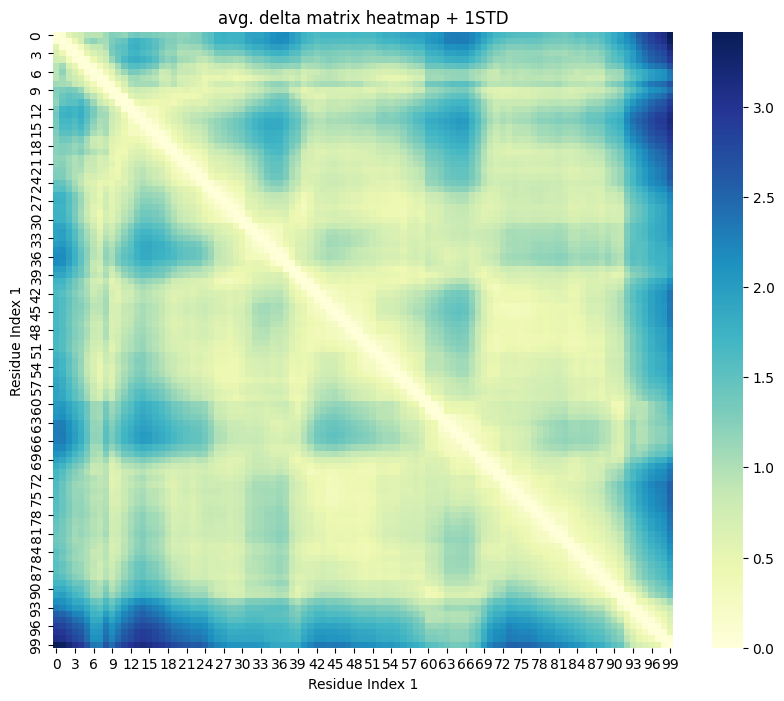

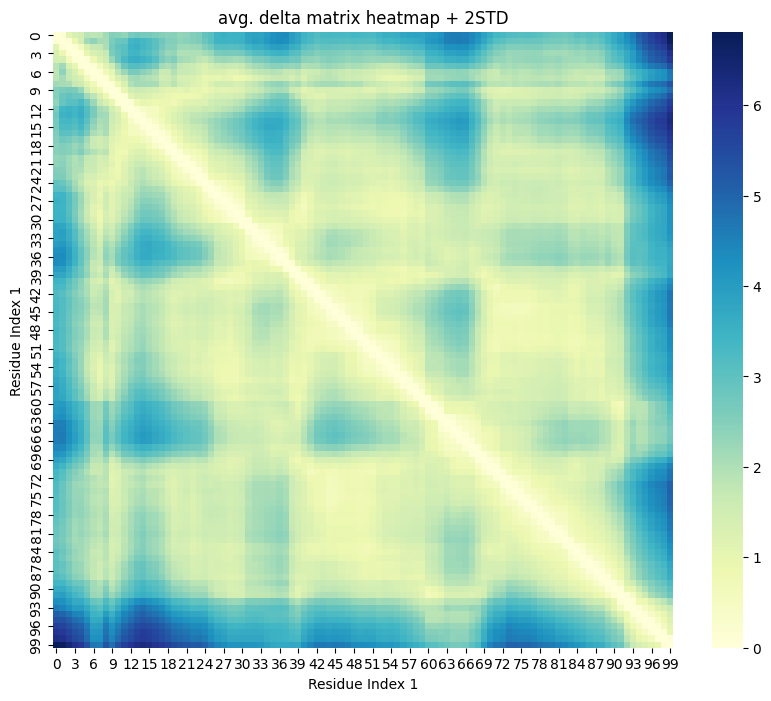

1.9190
something wrong with clustering Q computation


In [20]:
res_specvar = redpandda_general.main_clustering_general_std(df, None)

In [21]:
import redpandda_general
res_hdbscan = redpandda_general.main_clustering_general(df, None, clustering_algorithm="hdbscan")

0.0069


In [22]:
res_hdbscan

(array([-1, -1, -1, -1, -1,  5, -1,  4, -1,  4,  1,  1,  1,  1,  1,  1,  1,
        -1, -1,  1,  0, -1,  5,  5, -1,  5,  5,  5,  5,  5, -1, -1, -1, -1,
         5,  5,  5, -1, -1, -1,  5,  2, -1, -1,  1,  1,  1, -1,  1, -1,  0,
        -1, -1,  5,  5,  5,  5,  5, -1,  5,  5,  5,  6, -1,  6,  6,  3,  3,
        -1, -1, -1,  2, -1, -1,  1, -1,  1, -1, -1, -1, -1, -1, -1, -1, -1,
         5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5]),
 2.1102353436605754,
 array([[0.99967584, 0.99994696, 0.99991309, ..., 0.99994695, 0.99995211,
         1.        ],
        [0.99994696, 0.99967584, 0.99994536, ..., 0.99994306, 0.99993001,
         0.99995846],
        [0.99991309, 0.99994536, 0.99967584, ..., 0.99992266, 0.99992191,
         0.99993903],
        ...,
        [0.99994695, 0.99994306, 0.99992266, ..., 0.99967584, 0.99989966,
         0.99989427],
        [0.99995211, 0.99993001, 0.99992191, ..., 0.99989966, 0.99967584,
         0.9998871 ],
        [1.        , 0.99995846, 0.9

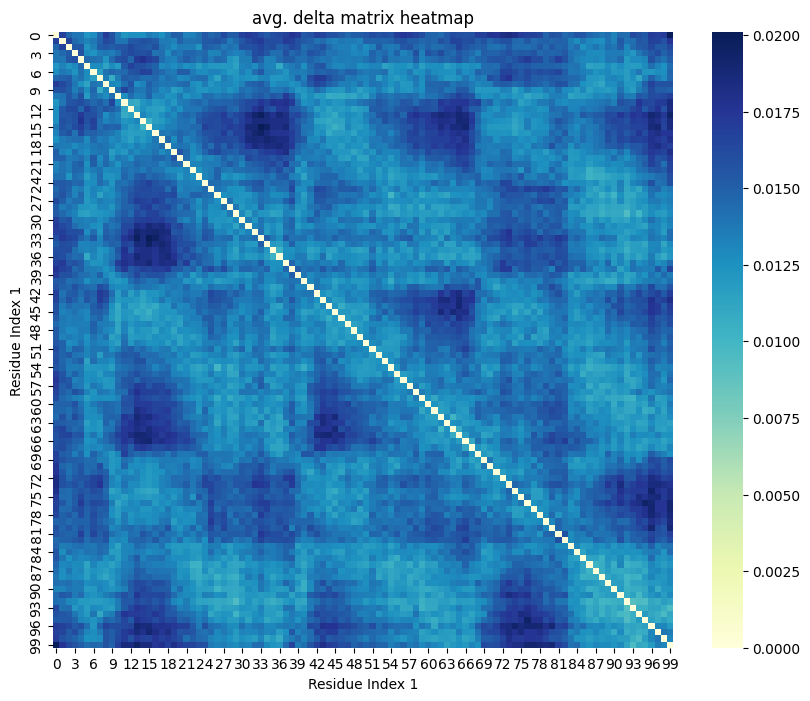

0.6115


In [23]:
res = redpandda_general.main_clustering_general(df, 2)

In [24]:
res_hdbscan = redpandda_general.main_clustering_general(df, None, clustering_algorithm="hdbscan", min_cluster_size=2, min_samples=1)

0.0108


In [25]:
res_hdbscan

(array([-1, -1, -1, -1, -1,  5, -1,  4, -1,  4,  1,  1,  1,  1,  1,  1,  1,
        -1, -1,  1,  0, -1,  5,  5, -1,  5,  5,  5,  5,  5, -1, -1, -1, -1,
         5,  5,  5, -1, -1, -1,  5,  2, -1, -1,  1,  1,  1, -1,  1, -1,  0,
        -1, -1,  5,  5,  5,  5,  5, -1,  5,  5,  5,  6, -1,  6,  6,  3,  3,
        -1, -1, -1,  2, -1, -1,  1, -1,  1, -1, -1, -1, -1, -1, -1, -1, -1,
         5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5]),
 2.1102353436605754,
 array([[0.99967584, 0.99994696, 0.99991309, ..., 0.99994695, 0.99995211,
         1.        ],
        [0.99994696, 0.99967584, 0.99994536, ..., 0.99994306, 0.99993001,
         0.99995846],
        [0.99991309, 0.99994536, 0.99967584, ..., 0.99992266, 0.99992191,
         0.99993903],
        ...,
        [0.99994695, 0.99994306, 0.99992266, ..., 0.99967584, 0.99989966,
         0.99989427],
        [0.99995211, 0.99993001, 0.99992191, ..., 0.99989966, 0.99967584,
         0.9998871 ],
        [1.        , 0.99995846, 0.9

In [26]:
res

(array([0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
        1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1,
        1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]),
 8.41763740177458,
 [],
 [array([[ 0],
         [ 1],
         [ 2],
         [ 3],
         [ 4],
         [ 5],
         [ 6],
         [ 7],
         [ 8],
         [ 9],
         [10],
         [11],
         [12],
         [13],
         [14],
         [15],
         [16],
         [17],
         [18],
         [19],
         [20],
         [21],
         [22],
         [23],
         [24],
         [25],
         [26],
         [27],
         [28],
         [29],
         [30],
         [31],
         [32],
         [33],
         [34],
         [35],
         [36],
         [37],
         [38],
         [39],
         [40],
         [41],
    

In [27]:
res_agglon = redpandda_general.main_clustering_general(df, None, clustering_algorithm="agglomerative")

something wrong with clustering Q computation


In [28]:
res_agglon

(array([85, 91, 95, 77, 79, 74, 93, 86, 73, 58, 82, 84, 69, 66, 94, 68, 54,
        53, 61, 78, 75, 63, 56, 42, 87, 50, 97, 51, 38, 92, 55, 52, 57, 71,
        72, 46, 25, 70, 59, 65, 90, 80, 28, 45, 89, 83, 35, 60, 99, 34, 81,
        29, 76, 32, 67, 88, 62, 39, 49, 22, 30, 43, 96, 26, 40, 37, 19, 36,
        17, 44, 21, 10, 98, 18, 47, 64, 33, 12, 48, 14, 31,  8, 16, 27, 13,
        41, 23, 24, 20, 15,  6,  9, 11,  4,  5,  2,  7,  3,  1,  0]),
 [],
 array([[0.        , 0.83638685, 0.73188551, ..., 0.83634557, 0.85227598,
         1.        ],
        [0.83638685, 0.        , 0.8314389 , ..., 0.82434662, 0.78409604,
         0.87186875],
        [0.73188551, 0.8314389 , 0.        , ..., 0.76140729, 0.75910326,
         0.81192861],
        ...,
        [0.83634557, 0.82434662, 0.76140729, ..., 0.        , 0.69045459,
         0.6738248 ],
        [0.85227598, 0.78409604, 0.75910326, ..., 0.69045459, 0.        ,
         0.65173194],
        [1.        , 0.87186875, 0.81192861, ..., 0.

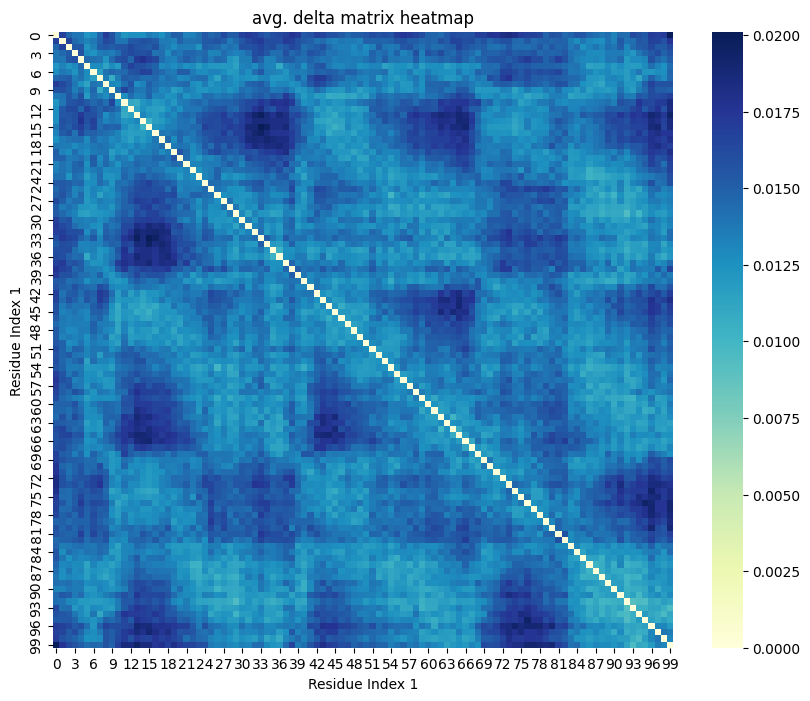

0.6539


In [29]:
res = redpandda_general.main_clustering_general(df, 6)

In [30]:
res_hdbscan = redpandda_general.main_clustering_general(df, None, clustering_algorithm="hdbscan")

0.0069


In [31]:
res_hdbscan

(array([-1, -1, -1, -1, -1,  5, -1,  4, -1,  4,  1,  1,  1,  1,  1,  1,  1,
        -1, -1,  1,  0, -1,  5,  5, -1,  5,  5,  5,  5,  5, -1, -1, -1, -1,
         5,  5,  5, -1, -1, -1,  5,  2, -1, -1,  1,  1,  1, -1,  1, -1,  0,
        -1, -1,  5,  5,  5,  5,  5, -1,  5,  5,  5,  6, -1,  6,  6,  3,  3,
        -1, -1, -1,  2, -1, -1,  1, -1,  1, -1, -1, -1, -1, -1, -1, -1, -1,
         5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5]),
 2.1102353436605754,
 array([[0.99967584, 0.99994696, 0.99991309, ..., 0.99994695, 0.99995211,
         1.        ],
        [0.99994696, 0.99967584, 0.99994536, ..., 0.99994306, 0.99993001,
         0.99995846],
        [0.99991309, 0.99994536, 0.99967584, ..., 0.99992266, 0.99992191,
         0.99993903],
        ...,
        [0.99994695, 0.99994306, 0.99992266, ..., 0.99967584, 0.99989966,
         0.99989427],
        [0.99995211, 0.99993001, 0.99992191, ..., 0.99989966, 0.99967584,
         0.9998871 ],
        [1.        , 0.99995846, 0.9

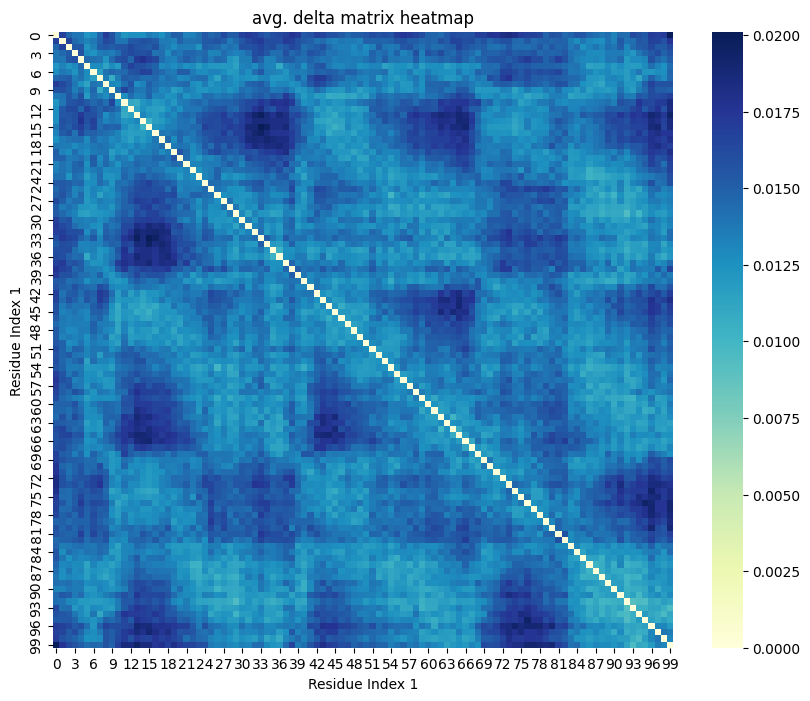

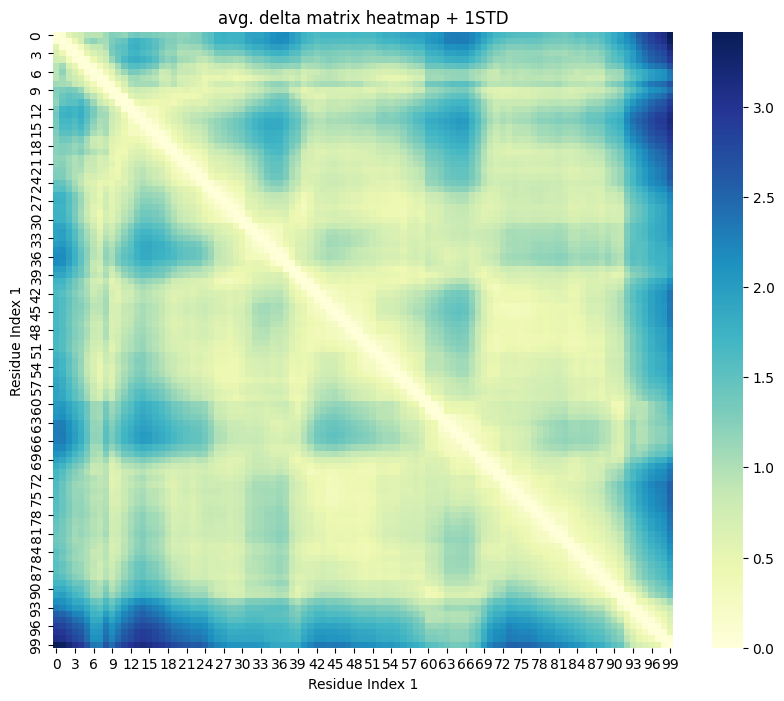

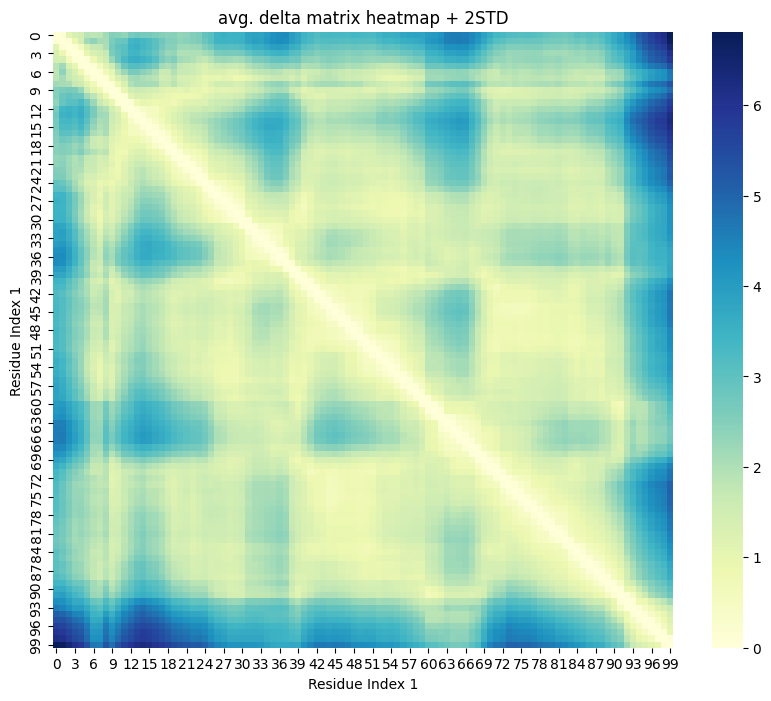

1.7167
something wrong with clustering Q computation


In [32]:
res_specvar = redpandda_general.main_clustering_general_std(df, None)

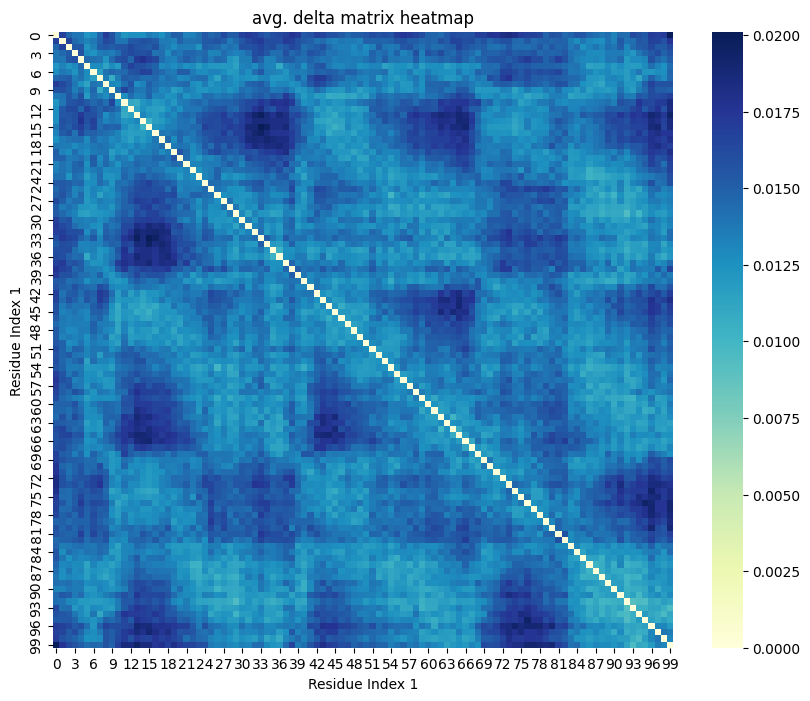

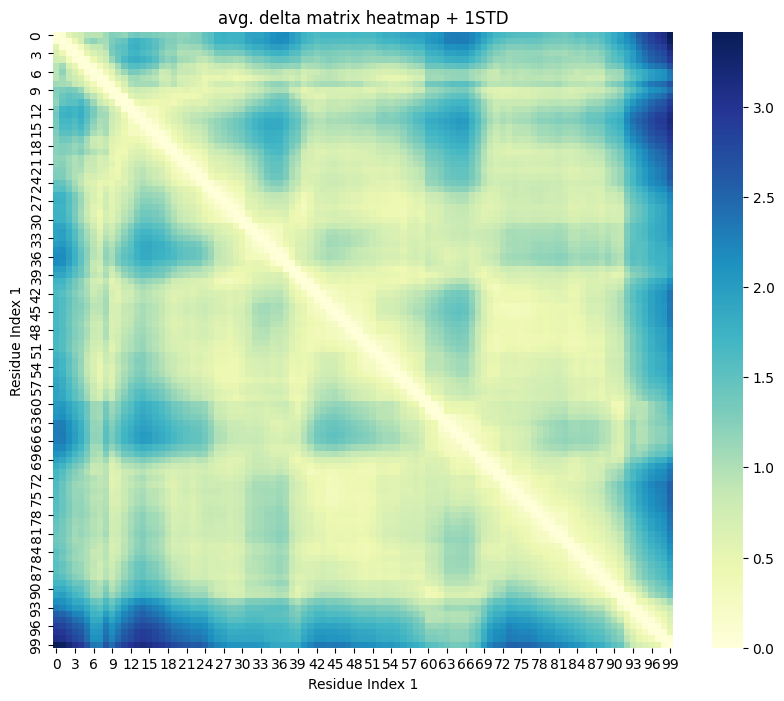

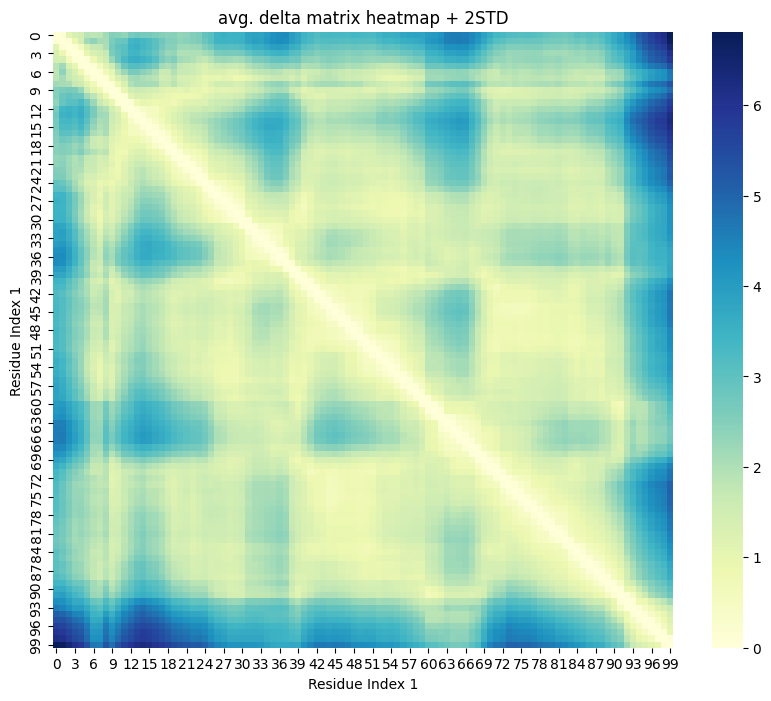

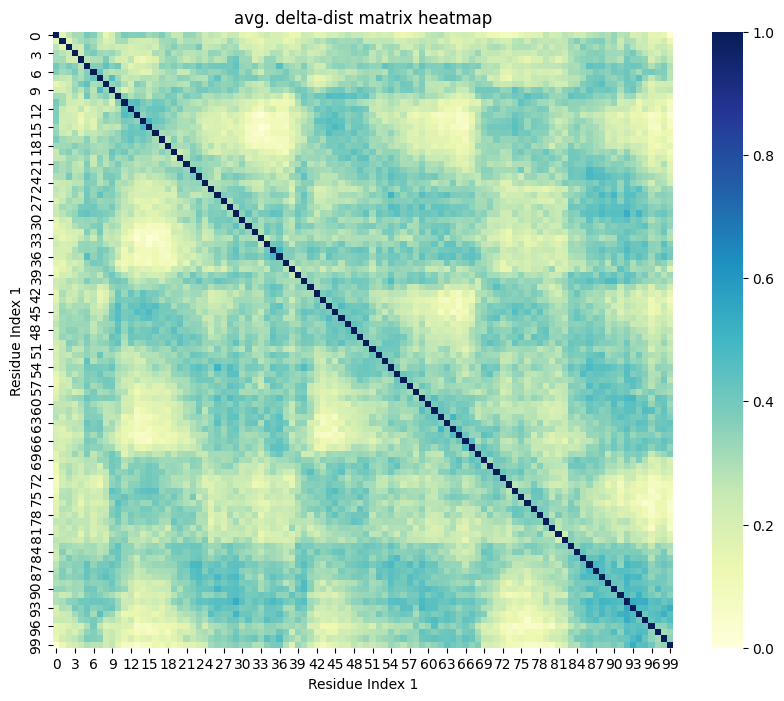

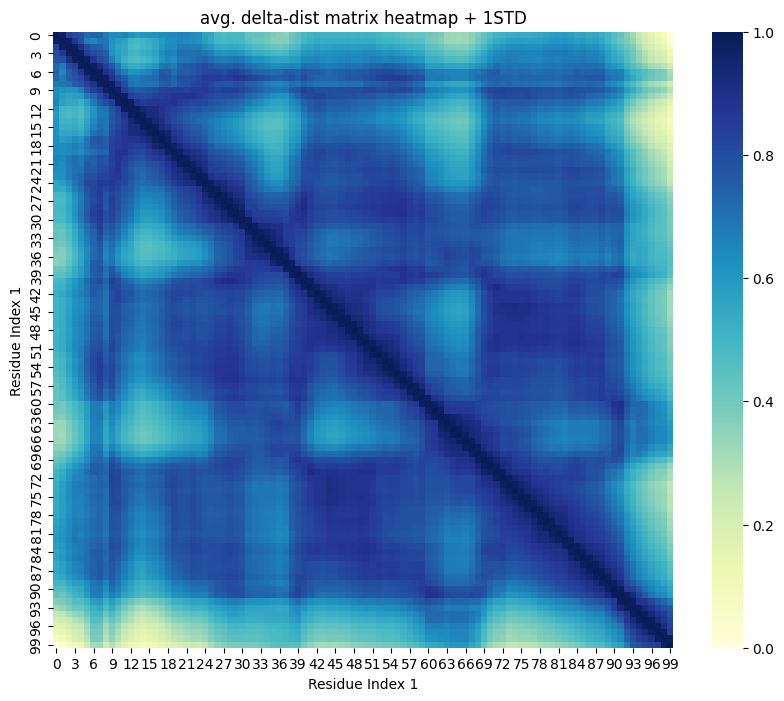

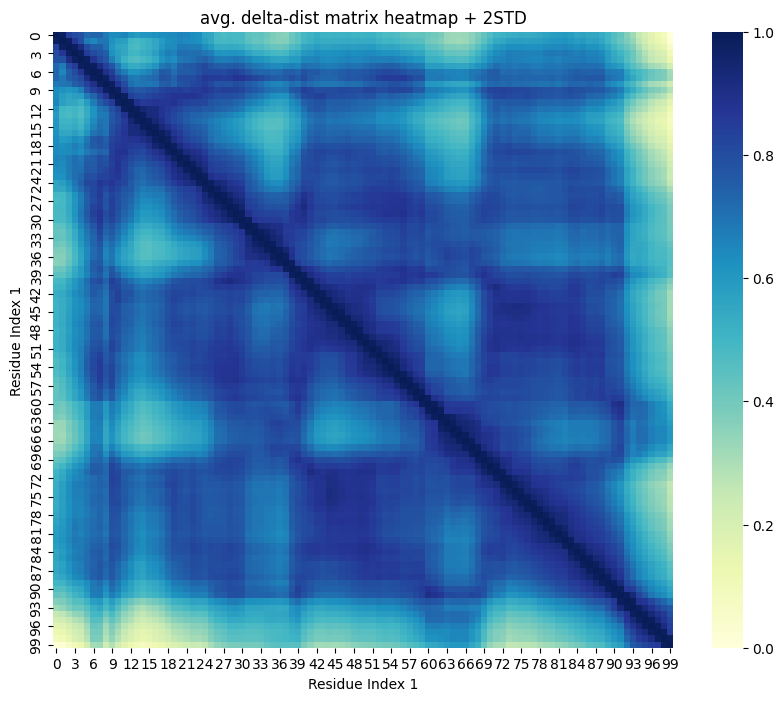

3.3670


In [33]:
res_specvar_distance = redpandda_general.main_clustering_general_std_distance(df, None)

In [34]:
result_labels = res[0]

In [35]:
result_labels

array([2, 2, 2, 4, 2, 4, 2, 4, 4, 4, 5, 2, 3, 3, 3, 3, 3, 3, 3, 4, 4, 4,
       4, 2, 4, 2, 2, 2, 2, 2, 5, 5, 5, 5, 5, 0, 0, 0, 4, 5, 2, 5, 5, 5,
       5, 5, 5, 5, 5, 5, 5, 4, 4, 4, 4, 4, 4, 4, 1, 1, 2, 2, 1, 1, 1, 1,
       0, 0, 0, 3, 3, 3, 3, 3, 1, 1, 1, 1, 1, 4, 4, 1, 1, 5, 5, 2, 2, 2,
       4, 2, 2, 2, 2, 2, 0, 2, 2, 2, 0, 0])

In [36]:
trajectories_results = []
for ip, particle_traj in enumerate(trajectories):
    trajectory_result = []

    for it, timestep in enumerate(particle_traj):
        trajectory_result.append([*timestep[:-1], result_labels[ip]])
    trajectories_results.append(trajectory_result)

In [37]:
trajectories_results = [
    [[*timestep[:-1], result_labels[ip]] for timestep in particle_traj]
    for ip, particle_traj in enumerate(trajectories)
]

In [38]:
traj_array, point_array, frames_count, n_objects = redpandda_general.prepare_data_from_df(df)

In [39]:
dist_matrices = redpandda_general.get_distance_matrices(traj_array)
delta_matrices = redpandda_general.get_delta_matrices(dist_matrices)
average_delta_matrix = redpandda_general.calculate_average_delta_matrix(delta_matrices)

std_delta_matrix = redpandda_general.get_std_matrices(dist_matrices)

In [40]:
std_delta_matrix

array([[0.        , 0.05617408, 0.5429935 , ..., 2.9767362 , 3.07954305,
        3.39551936],
       [0.05617408, 0.        , 0.05230637, ..., 2.92785453, 3.0298593 ,
        3.34171824],
       [0.5429935 , 0.05230637, 0.        , ..., 2.80035057, 2.89513764,
        3.1948692 ],
       ...,
       [2.9767362 , 2.92785453, 2.80035057, ..., 0.        , 0.04237797,
        0.47402712],
       [3.07954305, 3.0298593 , 2.89513764, ..., 0.04237797, 0.        ,
        0.04149798],
       [3.39551936, 3.34171824, 3.1948692 , ..., 0.47402712, 0.04149798,
        0.        ]])

In [41]:
summed_delta_matrix = average_delta_matrix

In [42]:
summed_delta_matrix_1std = summed_delta_matrix + std_delta_matrix 
summed_delta_matrix_2std = summed_delta_matrix + std_delta_matrix * 2

In [43]:
from distance_matrix import *

In [44]:
normed_delta_matrix = 1 - normed_values(summed_delta_matrix)
normed_delta_matrix_1std = 1 - normed_values(summed_delta_matrix_1std)
normed_delta_matrix_2std = 1 - normed_values(summed_delta_matrix_2std)

In [45]:
normed_similarity_matrix = 1 - normed_values(summed_delta_matrix)
normed_similarity_matrix_1std = 1 - normed_values(summed_delta_matrix_1std)
normed_similarity_matrix_2std = 1 - normed_values(summed_delta_matrix_2std)

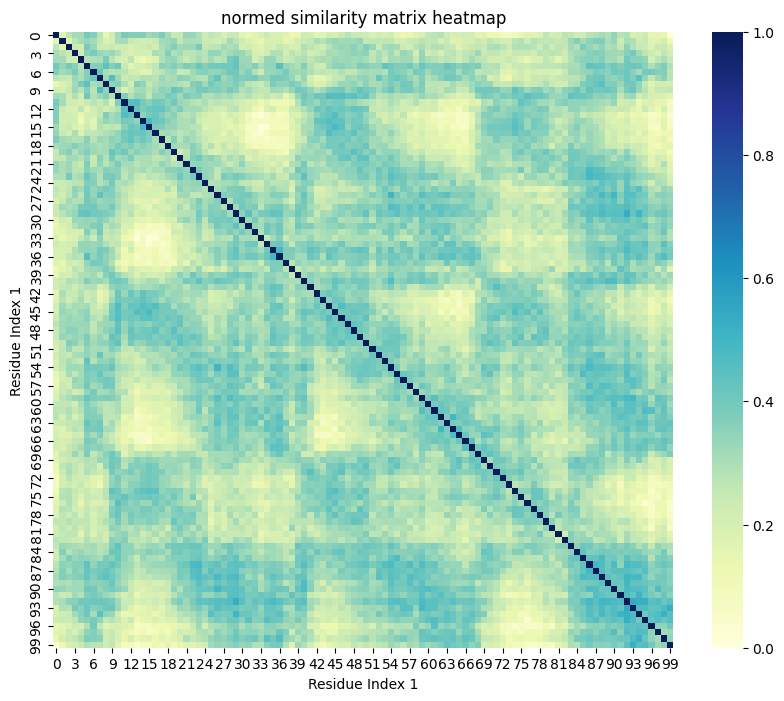

In [46]:
create_delta_heatmap(normed_similarity_matrix, title="normed similarity matrix heatmap")

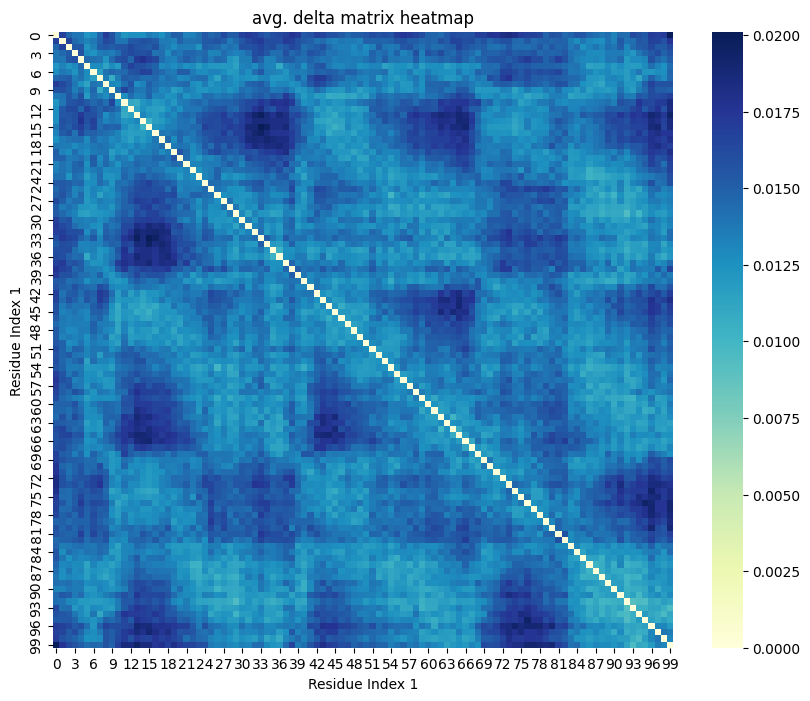

In [47]:
import distance_matrix
distance_matrix.create_delta_heatmap(average_delta_matrix, title="avg. delta matrix heatmap")

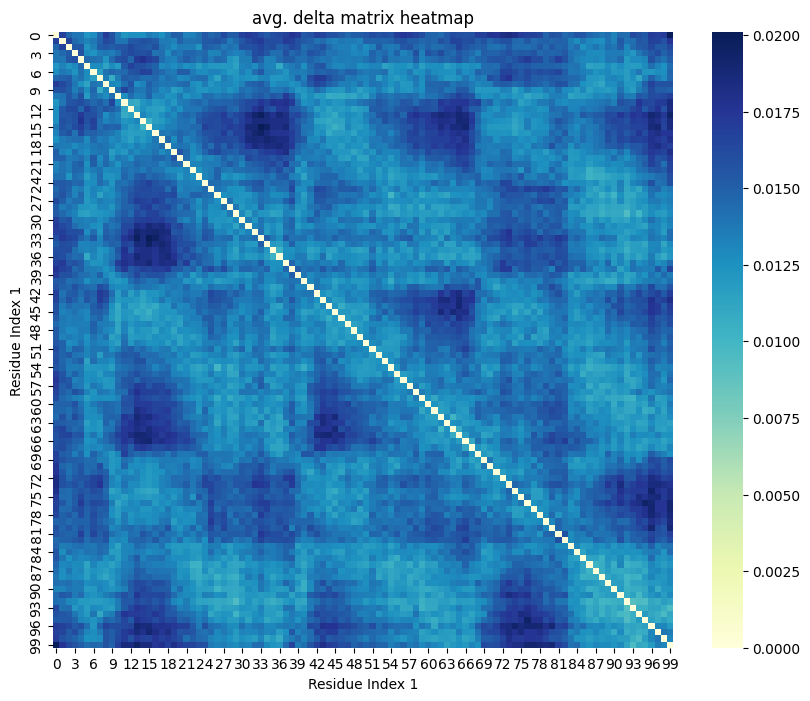

0.5384


array([4, 0, 2, 5, 5, 5, 0, 5, 5, 5, 2, 0, 4, 4, 4, 4, 4, 4, 4, 2, 2, 2,
       2, 2, 2, 5, 5, 0, 5, 5, 3, 3, 3, 3, 3, 3, 3, 3, 5, 3, 0, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 2, 5, 5, 2, 5, 5, 5, 2, 2, 0, 0, 0, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 3, 0, 5, 5,
       5, 2, 0, 5, 5, 5, 5, 0, 0, 0, 5, 5])

In [48]:
spectral_clustering_on_deltas(average_delta_matrix, 6)

In [49]:
clustering = SpectralClustering(n_clusters=6, affinity='precomputed')
result = clustering.fit(normed_similarity_matrix)

In [50]:
result.labels_

array([4, 1, 2, 3, 1, 3, 1, 3, 3, 3, 2, 4, 4, 4, 4, 4, 4, 4, 4, 2, 2, 2,
       2, 2, 2, 3, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 3, 0, 1, 0, 0, 0,
       0, 0, 0, 2, 0, 2, 2, 2, 3, 2, 2, 3, 3, 3, 2, 2, 1, 1, 5, 5, 5, 5,
       5, 5, 3, 5, 5, 5, 5, 5, 5, 5, 5, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1,
       3, 1, 1, 1, 1, 1, 3, 1, 1, 1, 1, 1], dtype=int32)

In [51]:
clustering = SpectralClustering(n_clusters=6, affinity='precomputed')
result = clustering.fit(summed_delta_matrix_2std)
print(result.labels_)

[0 2 0 2 2 0 3 5 0 5 3 5 3 0 0 0 0 0 0 0 0 0 0 0 2 0 0 0 0 0 4 0 4 0 0 0 0
 1 4 0 4 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 0 2 2 2 2 2 2 2 2 0 1 1 1 1
 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 1 1 0 0 0 1 1 0 0 0]


In [52]:
import hdbscan

clustering = hdbscan.HDBSCAN(min_cluster_size=4, min_samples=2, metric='precomputed') 

result = clustering.fit(summed_delta_matrix.astype(np.float64))

print(result.labels_)

[-1 -1 -1 -1 -1 -1 -1  0 -1  1  1  1 -1  1  1  1  1 -1 -1 -1 -1 -1  0  0
 -1  0  0  0  0  0 -1  0 -1 -1  0  0  0 -1 -1 -1  0 -1 -1 -1  1  1  1 -1
  1 -1 -1 -1 -1 -1  0  0  0  0 -1  0  0  0  0  0  0  0 -1  0 -1 -1 -1  1
 -1 -1  1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0]


In [53]:
import hdbscan

clustering = hdbscan.HDBSCAN(min_cluster_size=4, min_samples=2, metric='precomputed') 


result = clustering.fit(summed_delta_matrix_1std.astype(np.float64))

print(result.labels_)

[-1  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1 -1 -1 -1 -1
 -1 -1  2  2  2  2  2  2  2  2  2  5  5  5  5  6  6  6  6  6  6  6  6  6
  6  6  6  6  6 -1 -1 -1  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  4
  4  4  4  4  4  4  4  4 -1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1 -1]


In [54]:
import hdbscan

clustering = hdbscan.HDBSCAN(min_cluster_size=2, min_samples=2, metric='precomputed') 


result = clustering.fit(summed_delta_matrix_2std.astype(np.float64))

print(result.labels_)

[-1  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  1  1  3  3  4
  4  4  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  6  6  7  7  7  7  7  7  7  7  7  7  7  7  7  7  7  8
  8  8  8  8  8  8  8  8 -1 -1  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2 -1]


In [55]:
normed_delta_matrix = normed_values(summed_delta_matrix)
normed_delta_matrix_1std = normed_values(summed_delta_matrix_1std)
normed_delta_matrix_2std =  normed_values(summed_delta_matrix_2std)

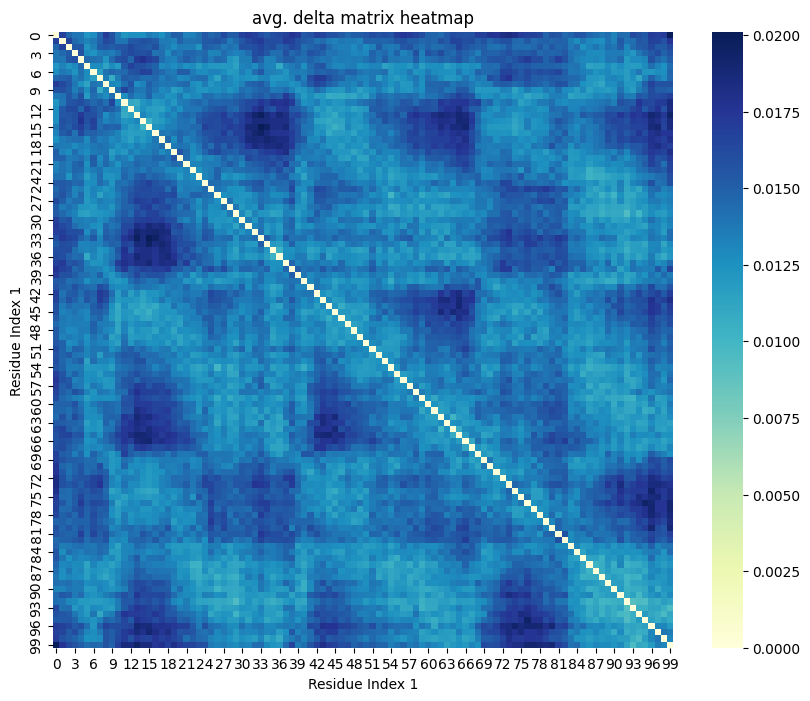

0.5564


array([2, 2, 2, 5, 4, 5, 2, 5, 5, 5, 2, 2, 4, 4, 4, 4, 4, 4, 4, 2, 5, 2,
       2, 2, 2, 5, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 5, 0, 2, 0, 4, 4,
       4, 4, 4, 4, 4, 4, 4, 3, 5, 5, 5, 5, 5, 5, 2, 2, 2, 2, 2, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 2, 2, 2, 2, 2, 5, 5,
       5, 2, 2, 5, 5, 5, 5, 0, 0, 0, 0, 0])

In [56]:
spectral_clustering_on_deltas(average_delta_matrix, 6)

In [57]:
clustering = AgglomerativeClustering(n_clusters=None, distance_threshold=0.1, affinity='precomputed', linkage='complete')

result = clustering.fit(average_delta_matrix)

In [58]:

clustering = AgglomerativeClustering(n_clusters=None, distance_threshold=0.7, metric='precomputed', linkage='complete')

result = clustering.fit(summed_delta_matrix_2std)

In [59]:
result.labels_

array([28, 28, 10, 10, 18, 18, 24, 24, 20, 20, 22, 22,  3,  3,  3,  3, 32,
       32, 12, 12, 30, 30,  4,  4,  4, 14, 14, 14, 17, 17, 25, 25,  2,  2,
        2,  2,  2, 21, 21,  6,  6,  6, 13, 13, 13, 13, 15, 15, 15, 15,  0,
        0,  0,  0,  0,  0,  1,  1,  1, 35, 35, 27, 27,  7,  7,  7,  7,  7,
        9,  9,  9, 34, 34, 16, 16, 16, 26, 26, 11, 11, 11, 11, 33, 33,  5,
        5,  5,  5, 23, 23, 29, 29, 19, 19,  8,  8,  8, 36, 31, 31])

In [60]:
import hdbscan

clustering = hdbscan.HDBSCAN(min_cluster_size=2, min_samples=2, metric='precomputed') 


result = clustering.fit(summed_delta_matrix_2std.astype(np.float64))

print(result.labels_)

[-1  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  1  1  3  3  4
  4  4  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  6  6  7  7  7  7  7  7  7  7  7  7  7  7  7  7  7  8
  8  8  8  8  8  8  8  8 -1 -1  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2 -1]


In [61]:
import hdbscan

clustering = hdbscan.HDBSCAN(min_cluster_size=2, min_samples=2, metric='precomputed') 


result = clustering.fit(summed_delta_matrix.astype(np.float64))

print(result.labels_)

[-1 -1 -1 -1 -1 -1 -1  0 -1  1  1  1 -1  1  1  1  1 -1 -1 -1 -1 -1  0  0
 -1  0  0  0  0  0 -1  0 -1 -1  0  0  0 -1 -1 -1  0 -1 -1 -1  1  1  1 -1
  1 -1 -1 -1 -1 -1  0  0  0  0 -1  0  0  0  0  0  0  0 -1  0 -1 -1 -1  1
 -1 -1  1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0]


In [62]:
import hdbscan

clustering = hdbscan.HDBSCAN(min_cluster_size=2, min_samples=2, metric='precomputed') 


result = clustering.fit(normed_delta_matrix_2std.astype(np.float64))

print(result.labels_)

[-1  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  1  1  3  3  4
  4  4  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  6  6  7  7  7  7  7  7  7  7  7  7  7  7  7  7  7  8
  8  8  8  8  8  8  8  8 -1 -1  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2 -1]


In [63]:
#FF

In [64]:
clustering = SpectralClustering(n_clusters=6, affinity='precomputed')
result_spectral_6 = clustering.fit(normed_similarity_matrix)

clustering = SpectralClustering(n_clusters=3, affinity='precomputed')
result_spectral_3 = clustering.fit(normed_similarity_matrix)

In [65]:
clustering = SpectralClustering(n_clusters=6, affinity='precomputed', assign_labels="discretize")
result_spectral_6_discr = clustering.fit(normed_similarity_matrix)

In [66]:
clustering = SpectralClustering(n_clusters=6, affinity='precomputed', assign_labels="discretize")
result_spectral_6_discr = clustering.fit(normed_similarity_matrix)
result_spectral_6_discr.labels_

array([2, 2, 2, 1, 1, 1, 1, 1, 1, 4, 2, 2, 5, 5, 5, 5, 5, 5, 5, 4, 4, 4,
       4, 4, 4, 1, 1, 2, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 4, 0, 2, 0, 5, 5,
       5, 5, 5, 5, 5, 5, 5, 4, 4, 4, 4, 4, 4, 4, 4, 4, 2, 2, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 4, 4, 4, 4, 4, 4, 2, 2, 2, 1, 1,
       1, 2, 2, 1, 1, 1, 1, 1, 1, 0, 1, 1])

In [67]:
clustering = SpectralClustering(n_clusters=3, affinity='precomputed', assign_labels="discretize")
result_spectral_3_discr = clustering.fit(normed_similarity_matrix)
result_spectral_3_discr.labels_

array([1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0])

In [68]:
clustering = SpectralClustering(n_clusters=6, affinity='precomputed', assign_labels="cluster_qr")
result_spectral_6_discr = clustering.fit(normed_similarity_matrix)
result_spectral_6_discr.labels_

array([0, 0, 0, 3, 5, 4, 0, 3, 3, 4, 2, 0, 2, 0, 0, 0, 0, 0, 0, 4, 4, 4,
       4, 4, 4, 0, 5, 5, 5, 5, 5, 2, 0, 5, 5, 0, 0, 0, 4, 2, 2, 2, 2, 2,
       2, 2, 2, 4, 3, 4, 4, 4, 4, 4, 4, 4, 4, 4, 1, 4, 1, 1, 1, 1, 1, 1,
       1, 3, 3, 3, 3, 1, 1, 1, 1, 1, 1, 4, 4, 4, 4, 4, 4, 3, 2, 0, 5, 0,
       5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5])

In [69]:
clustering = SpectralClustering(n_clusters=6, affinity='precomputed')
result_spectral_6_discr = clustering.fit(normed_similarity_matrix)
result_spectral_6_discr.labels_

array([0, 1, 1, 4, 5, 5, 5, 4, 4, 4, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1,
       1, 1, 1, 5, 5, 5, 5, 5, 2, 2, 2, 2, 2, 2, 2, 4, 4, 2, 1, 2, 2, 2,
       2, 2, 2, 4, 4, 4, 4, 1, 4, 4, 1, 4, 4, 4, 1, 1, 5, 5, 3, 3, 3, 3,
       3, 3, 4, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 1, 1, 1, 1, 1, 5, 5, 5,
       5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5], dtype=int32)

In [70]:
result_spectral_3.labels_

array([1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 2, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 1, 1, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], dtype=int32)

In [71]:
result_spectral_6.labels_

array([5, 3, 3, 0, 4, 4, 4, 0, 0, 0, 3, 5, 5, 5, 5, 5, 5, 5, 5, 3, 3, 3,
       3, 3, 3, 4, 4, 4, 4, 4, 4, 2, 2, 2, 2, 2, 2, 0, 0, 2, 3, 2, 2, 2,
       2, 2, 2, 0, 0, 0, 0, 3, 0, 0, 3, 0, 0, 0, 3, 3, 1, 1, 1, 1, 1, 1,
       1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 4, 4, 4,
       4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4], dtype=int32)

In [72]:
result_spectral_6_discr.labels_

array([0, 1, 1, 4, 5, 5, 5, 4, 4, 4, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1,
       1, 1, 1, 5, 5, 5, 5, 5, 2, 2, 2, 2, 2, 2, 2, 4, 4, 2, 1, 2, 2, 2,
       2, 2, 2, 4, 4, 4, 4, 1, 4, 4, 1, 4, 4, 4, 1, 1, 5, 5, 3, 3, 3, 3,
       3, 3, 4, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 1, 1, 1, 1, 1, 5, 5, 5,
       5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5], dtype=int32)

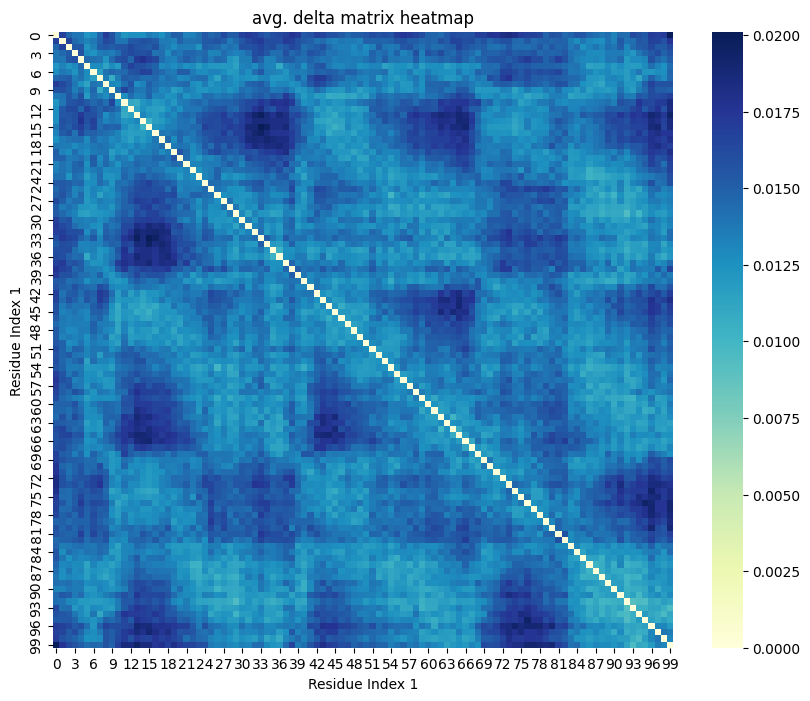

0.5461


array([1, 1, 1, 3, 3, 3, 3, 3, 3, 0, 2, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0,
       0, 0, 0, 3, 3, 2, 2, 3, 2, 2, 2, 2, 5, 5, 5, 5, 0, 2, 2, 2, 5, 5,
       5, 5, 5, 5, 5, 5, 5, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 2, 2, 4, 4, 4,
       4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 0, 0, 0, 0, 0, 0, 2, 2, 2, 3, 3,
       3, 2, 2, 3, 3, 3, 3, 3, 3, 2, 3, 3])

In [73]:
distance_matrix.spectral_clustering_on_deltas(summed_delta_matrix, 6)

In [74]:
normed_similarity_matrix = 1 - normed_values(summed_delta_matrix)


In [75]:
clustering = SpectralClustering(n_clusters=6, affinity='precomputed')
result = clustering.fit(summed_delta_matrix_2std)
print(result.labels_)

[2 1 2 2 1 2 5 0 2 0 5 0 5 1 1 1 1 1 1 1 1 1 1 1 2 1 1 1 1 1 3 1 3 1 1 1 1
 4 1 1 3 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 1 2 2 2 2 2 2 2 2 1 4 4 4 4
 4 4 4 4 1 1 1 1 1 1 1 1 1 1 1 1 4 4 1 1 1 4 4 1 1 1]


In [76]:
import hdbscan

clustering = hdbscan.HDBSCAN(min_cluster_size=4, min_samples=2, metric='precomputed') 

result_hdbscan_4_2 = clustering.fit(summed_delta_matrix.astype(np.float64))

print(result_hdbscan_4_2.labels_)

[-1 -1 -1 -1 -1 -1 -1  0 -1  1  1  1 -1  1  1  1  1 -1 -1 -1 -1 -1  0  0
 -1  0  0  0  0  0 -1  0 -1 -1  0  0  0 -1 -1 -1  0 -1 -1 -1  1  1  1 -1
  1 -1 -1 -1 -1 -1  0  0  0  0 -1  0  0  0  0  0  0  0 -1  0 -1 -1 -1  1
 -1 -1  1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0]


In [77]:
import hdbscan

clustering = hdbscan.HDBSCAN(min_cluster_size=4, min_samples=2, metric='precomputed') 


result_hdbscan_4_2_1std = clustering.fit(summed_delta_matrix_1std.astype(np.float64))

print(result_hdbscan_4_2_1std.labels_)

[-1  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1 -1 -1 -1 -1
 -1 -1  2  2  2  2  2  2  2  2  2  5  5  5  5  6  6  6  6  6  6  6  6  6
  6  6  6  6  6 -1 -1 -1  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  4
  4  4  4  4  4  4  4  4 -1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1 -1]


In [78]:
import hdbscan

clustering = hdbscan.HDBSCAN(min_cluster_size=2, min_samples=2, metric='precomputed') 


result_hdbscan_2_2_2std = clustering.fit(summed_delta_matrix_2std.astype(np.float64))

print(result_hdbscan_2_2_2std.labels_)

[-1  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  1  1  3  3  4
  4  4  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  6  6  7  7  7  7  7  7  7  7  7  7  7  7  7  7  7  8
  8  8  8  8  8  8  8  8 -1 -1  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2 -1]


In [79]:
normed_delta_matrix = normed_values(summed_delta_matrix)
normed_delta_matrix_1std = normed_values(summed_delta_matrix_1std)
normed_delta_matrix_2std =  normed_values(summed_delta_matrix_2std)

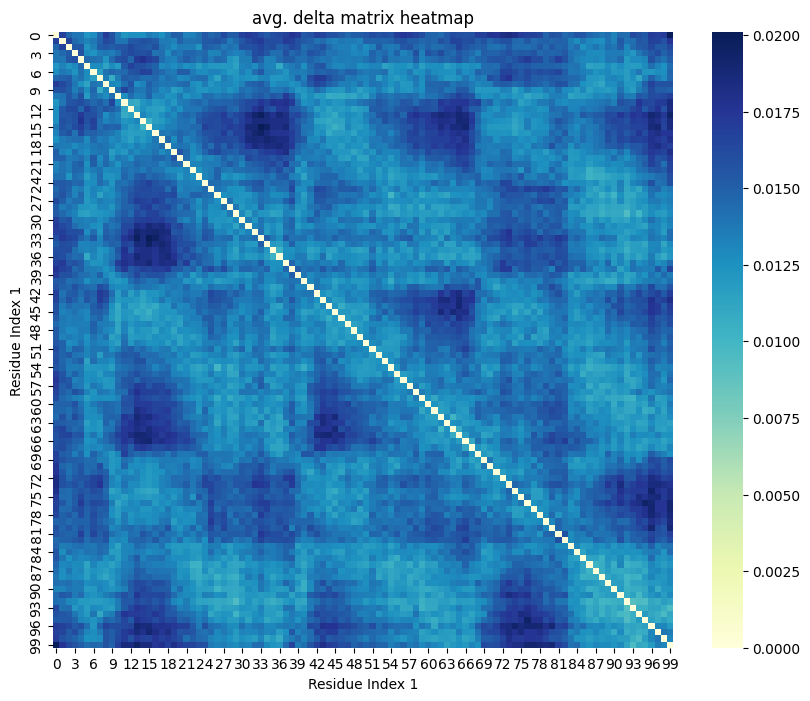

0.5036


array([2, 2, 2, 5, 4, 5, 2, 5, 5, 5, 2, 2, 4, 4, 4, 4, 4, 4, 4, 2, 5, 2,
       2, 2, 2, 5, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 5, 0, 2, 0, 4, 4,
       4, 4, 4, 4, 4, 4, 4, 3, 5, 5, 5, 5, 5, 5, 2, 2, 2, 2, 2, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 2, 2, 2, 2, 2, 5, 5,
       5, 2, 2, 5, 5, 5, 5, 0, 0, 0, 0, 0])

In [80]:
spectral_clustering_on_deltas(average_delta_matrix, 6)

In [81]:
clustering = AgglomerativeClustering(n_clusters=None, distance_threshold=0.1, affinity='precomputed', linkage='complete')

result_agglo_compl_dt01 = clustering.fit(average_delta_matrix)

In [82]:

clustering = AgglomerativeClustering(n_clusters=None, distance_threshold=0.7, metric='precomputed', linkage='complete')

result_agglo_compl_dt07_2std  = clustering.fit(summed_delta_matrix_2std)

In [83]:

clustering = AgglomerativeClustering(n_clusters=3, metric='precomputed', linkage='complete')

result_agglo_cl3  = clustering.fit(average_delta_matrix)

In [84]:
result_agglo_compl_dt01.labels_

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0])

In [85]:
result_agglo_cl3.labels_

array([0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 2, 2, 2, 2, 2, 2, 0, 0, 2, 0, 0,
       0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 2, 2, 2,
       0, 2, 0, 0, 2, 2, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 0, 1, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 2, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1])

In [86]:
import hdbscan

clustering = hdbscan.HDBSCAN(min_cluster_size=2, min_samples=2, metric='precomputed') 


result_hdbscan_2_2 = clustering.fit(summed_delta_matrix.astype(np.float64))

print(result_hdbscan_2_2.labels_)

[-1 -1 -1 -1 -1 -1 -1  0 -1  1  1  1 -1  1  1  1  1 -1 -1 -1 -1 -1  0  0
 -1  0  0  0  0  0 -1  0 -1 -1  0  0  0 -1 -1 -1  0 -1 -1 -1  1  1  1 -1
  1 -1 -1 -1 -1 -1  0  0  0  0 -1  0  0  0  0  0  0  0 -1  0 -1 -1 -1  1
 -1 -1  1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0]


In [87]:
result_hdbscan_2_2_2std.labels_

array([-1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  1,  1,  3,  3,  4,  4,  4,  5,  5,  5,  5,  5,  5,  5,  5,
        5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,
        5,  5,  5,  6,  6,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,
        7,  7,  7,  8,  8,  8,  8,  8,  8,  8,  8,  8, -1, -1,  2,  2,  2,
        2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2, -1])

In [88]:
true_labels = groups_list[:,0]

In [89]:
residue_items = list(range(len(true_labels)))

In [90]:
import visualizations


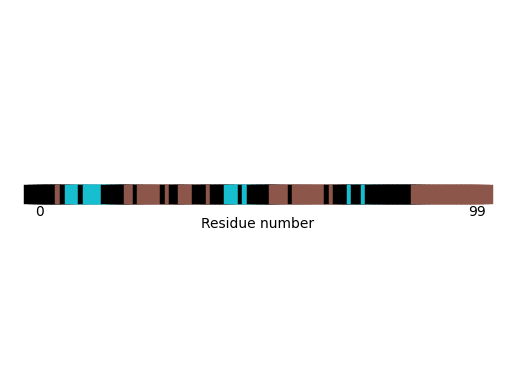

In [91]:
visualizations.plot_residue_line_plus_noise(residue_items, result_hdbscan_2_2.labels_)

In [92]:
from sklearn.cluster import AffinityPropagation

In [93]:
clustering_aff = AffinityPropagation(random_state=5, affinity="precomputed").fit(normed_similarity_matrix.astype(np.float64))
clustering_aff_1std = AffinityPropagation(random_state=5, affinity="precomputed").fit(normed_similarity_matrix_1std.astype(np.float64))
clustering_aff_2std = AffinityPropagation(random_state=5, affinity="precomputed").fit(normed_similarity_matrix_2std.astype(np.float64))

In [94]:
clustering.labels_

array([-1, -1, -1, -1, -1, -1, -1,  0, -1,  1,  1,  1, -1,  1,  1,  1,  1,
       -1, -1, -1, -1, -1,  0,  0, -1,  0,  0,  0,  0,  0, -1,  0, -1, -1,
        0,  0,  0, -1, -1, -1,  0, -1, -1, -1,  1,  1,  1, -1,  1, -1, -1,
       -1, -1, -1,  0,  0,  0,  0, -1,  0,  0,  0,  0,  0,  0,  0, -1,  0,
       -1, -1, -1,  1, -1, -1,  1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1,
        0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])

In [95]:
clustering_aff_1std.labels_

array([ 0,  0,  0,  1,  1,  1,  2,  2,  2,  3,  3,  3,  4,  4,  4,  4,  4,
        4,  4,  5,  5,  5,  5,  5,  6,  6,  6,  6,  6,  6,  6,  7,  7,  7,
        7,  7,  7,  7,  8,  8,  8,  8,  9,  9,  9,  9,  9,  9,  9,  9, 10,
       10, 10, 10, 10, 10, 11, 11, 11, 11, 11, 11, 12, 12, 12, 12, 12, 12,
       13, 13, 13, 13, 14, 14, 14, 14, 14, 14, 15, 15, 15, 15, 15, 16, 16,
       16, 16, 17, 17, 17, 17, 18, 18, 18, 18, 18, 19, 19, 19, 19])

In [96]:
clustering_aff_2std.labels_

array([ 0,  0,  0,  1,  1,  1,  2,  2,  2,  3,  3,  3,  4,  4,  4,  4,  4,
        4,  4,  5,  5,  5,  5,  5,  6,  6,  6,  6,  6,  6,  6,  7,  7,  7,
        7,  7,  7,  7,  8,  8,  8,  8,  9,  9,  9,  9,  9,  9,  9,  9, 10,
       10, 10, 10, 10, 10, 11, 11, 11, 11, 11, 11, 12, 12, 12, 12, 12, 12,
       13, 13, 13, 13, 14, 14, 14, 14, 14, 14, 15, 15, 15, 15, 15, 16, 16,
       16, 16, 17, 17, 17, 17, 18, 18, 18, 18, 18, 19, 19, 19, 19])

In [97]:
res_hdbscan_2_1 = redpandda_general.main_clustering_general(df, None, clustering_algorithm="hdbscan", min_cluster_size=2, min_samples=1)

0.0038


In [98]:
clustering_names = []
clustering_results = []

clustering_names.append("hdbscan, min_cluster:2, min_samples:1")
clustering_results.append(list(res_hdbscan_2_1[0]))
clustering_names.append("hdbscan, +2std, min_cluster:2, min_samples:1")
clustering_results.append(list(res_hdbscan_2std[0]))

clustering_names.append("hdbscan, min_cluster:2, min_samples:2")
clustering_results.append(list(result_hdbscan_2_2.labels_))
clustering_names.append("hdbscan, +2std, min_cluster:2, min_samples:2")
clustering_results.append(list(result_hdbscan_2_2_2std.labels_))
clustering_names.append("hdbscan, min_cluster:4, min_samples:2")
clustering_results.append(list(result_hdbscan_4_2.labels_))
clustering_names.append("hdbscan, +1std, min_cluster:4, min_samples:2")
clustering_results.append(list(result_hdbscan_4_2_1std.labels_))



clustering_names.append("spectral,  clusters:6")
clustering_results.append(list(result_spectral_6.labels_))
clustering_names.append("spectral,  clusters:3")
clustering_results.append(list(result_spectral_3.labels_))

clustering_names.append("affinity prop")
clustering_results.append(list(clustering_aff.labels_))
clustering_names.append("affinity prop, +1std")
clustering_results.append(list(clustering_aff_1std.labels_))
clustering_names.append("affinity prop, +1std")
clustering_results.append(list(clustering_aff_2std.labels_))


In [99]:
import numpy as np
from scipy.optimize import linear_sum_assignment
from sklearn.metrics import confusion_matrix

def evaluate_clustering_nr_wrong_elements(true_labels, predicted_labels):

    cm = confusion_matrix(true_labels, predicted_labels)
    
    # Hungarian / Munkres algorithm
    row_ind, col_ind = linear_sum_assignment(-cm)
    
    correctly_clustered = cm[row_ind, col_ind].sum()
    
    total_items = len(true_labels)
    wrongly_clustered = total_items - correctly_clustered
    
    return wrongly_clustered

In [100]:
traj_array = np.array(trajectories)[:,:,:-1]

In [101]:
traj_array = np.array(trajectories)[:,:,:-1]

In [102]:
flattened_array = traj_array.reshape(traj_array.shape[0], -1)

In [103]:
clustering = hdbscan.HDBSCAN(min_cluster_size=2, min_samples=2) 


result_hdbscan_2_2_flat = clustering.fit(flattened_array.astype(np.float64))


In [104]:
result_hdbscan_2_2_flat.labels_


array([-1,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,
        2,  2, -1, -1,  4,  4,  4,  4,  4,  5,  5,  5,  5,  5,  5,  5,  5,
        5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,
        5,  5,  5, -1,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,
        3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3, -1,  1,  1,  0,  0,
        0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0, -1])

In [105]:
clustering = SpectralClustering(n_clusters=3)
result_spectral_3_flat = clustering.fit(flattened_array)

In [106]:
result_spectral_3_flat.labels_

array([1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 2, 1, 0, 0, 1, 1, 2, 1, 0, 2, 1, 1,
       2, 2, 1, 2, 0, 2, 2, 1, 2, 0, 0, 0, 1, 1, 2, 0, 1, 2, 1, 0, 0, 2,
       2, 2, 2, 1, 2, 0, 1, 2, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 2, 2, 2, 1,
       1, 0, 2, 0, 0, 0, 2, 0, 0, 1, 2, 2, 0, 0, 0, 1, 0, 2, 1, 2, 0, 0,
       1, 0, 0, 0, 1, 2, 2, 0, 1, 2, 1, 0], dtype=int32)

In [107]:
vels_to_cluster = process_data.simulation_to_array_velocities(particles_from_sim)

In [108]:
traj_array_vel = np.array(vels_to_cluster)[:,:,:-1]
flattened_array_vel = traj_array_vel.reshape(traj_array_vel.shape[0], -1)

In [109]:
clustering = SpectralClustering(n_clusters=3)
result_spectral_3_flat = clustering.fit(flattened_array_vel)
result_spectral_3_flat.labels_

array([1, 0, 0, 1, 1, 0, 2, 2, 2, 2, 0, 1, 1, 1, 1, 1, 1, 2, 2, 0, 2, 1,
       0, 2, 2, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 2, 1, 2,
       2, 1, 0, 0, 1, 0, 0, 2, 1, 1, 1, 0, 2, 1, 1, 0, 0, 1, 1, 1, 0, 2,
       1, 1, 2, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 2, 1, 2, 0, 1, 0, 0, 0,
       2, 0, 1, 2, 1, 2, 1, 0, 2, 0, 0, 0], dtype=int32)

In [110]:
clustering = hdbscan.HDBSCAN(min_cluster_size=2, min_samples=2) 


result_hdbscan_2_2_flat = clustering.fit(flattened_array_vel.astype(np.float64))
result_hdbscan_2_2_flat.labels_

clustering_names.append("hdbscan, flattened velocities, 2, 2")
clustering_results.append(list(result_hdbscan_2_2_flat.labels_))

In [111]:
result_hdbscan_2_2.labels_

array([-1, -1, -1, -1, -1, -1, -1,  0, -1,  1,  1,  1, -1,  1,  1,  1,  1,
       -1, -1, -1, -1, -1,  0,  0, -1,  0,  0,  0,  0,  0, -1,  0, -1, -1,
        0,  0,  0, -1, -1, -1,  0, -1, -1, -1,  1,  1,  1, -1,  1, -1, -1,
       -1, -1, -1,  0,  0,  0,  0, -1,  0,  0,  0,  0,  0,  0,  0, -1,  0,
       -1, -1, -1,  1, -1, -1,  1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1,
        0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])

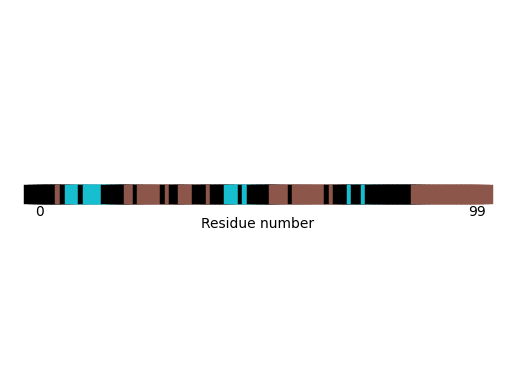

In [112]:
visualizations.plot_residue_line_plus_noise(residue_items, result_hdbscan_2_2.labels_)

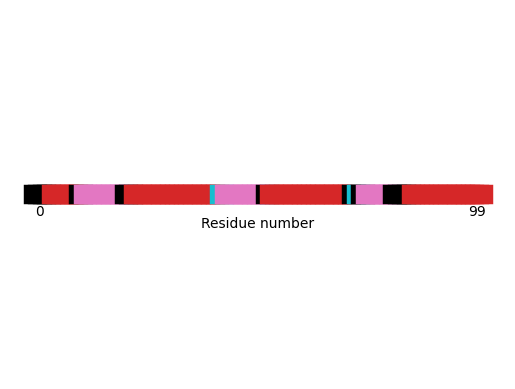

In [113]:
visualizations.plot_residue_line_plus_noise(residue_items, result_hdbscan_2_2_flat.labels_)

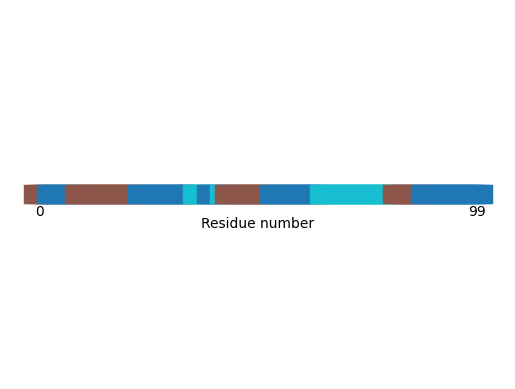

In [114]:
visualizations.plot_residue_line_plus_noise(residue_items, result_spectral_3.labels_)

In [115]:
import sklearn 
def get_clustering_similarity_true(true_clustering, clusterings, sim_function = sklearn.metrics.adjusted_rand_score):
    sim_results = []
    for i in range(len(clusterings)):
        sim_result = sim_function(true_clustering, clusterings[i])
        sim_results.append(sim_result)
    return sim_results

def get_clustering_similarity_true_trajectories(true_clusterings, clusterings, sim_function = sklearn.metrics.adjusted_rand_score):
    sim_results = []
    for i in range(len(clusterings)):
        sim_result = sim_function(true_clusterings[i], clusterings[i])
        sim_results.append(sim_result)
    return sim_result



Text(0.5, 1.0, 'adjusted rand score')

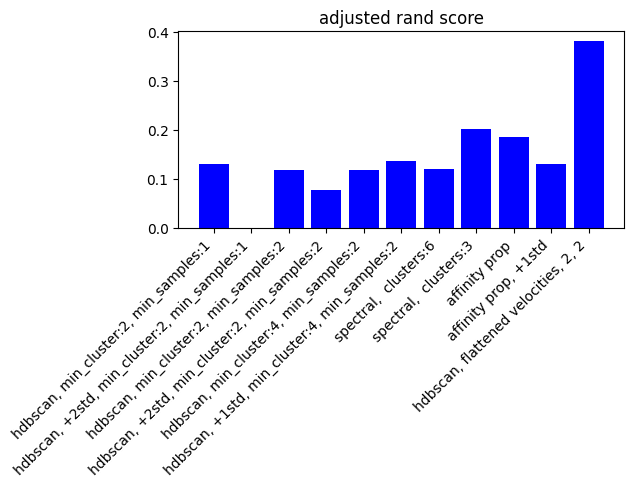

In [116]:
sim_scores = get_clustering_similarity_true(true_labels, clustering_results)
plt.bar(clustering_names, sim_scores, color='blue')
plt.xticks(rotation=45, ha='right')  

plt.tight_layout()

plt.title("adjusted rand score")

Text(0.5, 1.0, 'adjusted rand score')

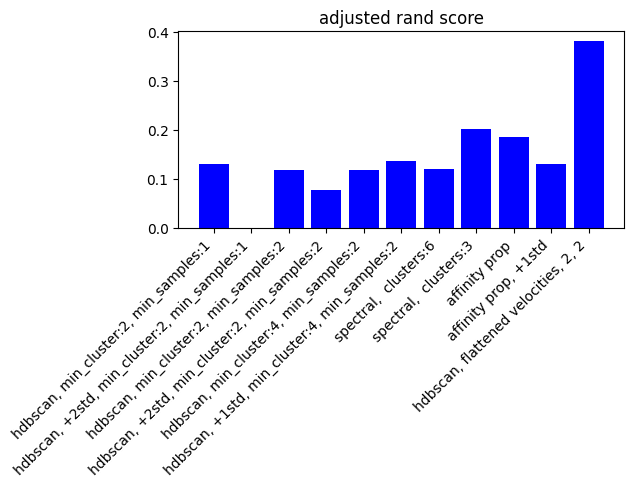

In [117]:
sim_scores = get_clustering_similarity_true(true_labels, clustering_results)
plt.bar(clustering_names, sim_scores, color='blue')
plt.xticks(rotation=45, ha='right')  

plt.tight_layout()

plt.title("adjusted rand score")

Text(0.5, 1.0, 'nr. of wrong elements')

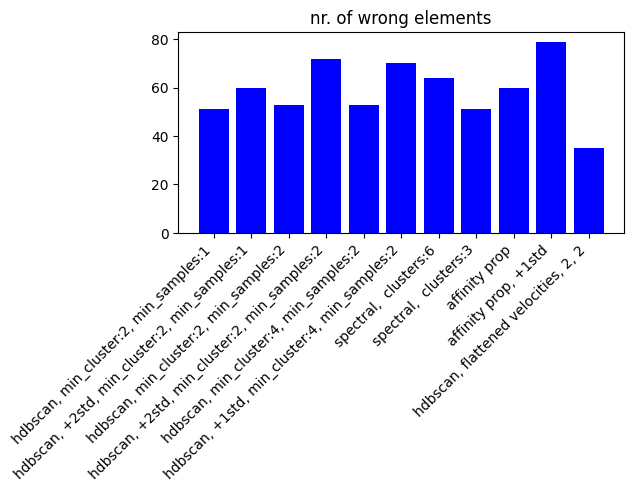

In [118]:
sim_scores = get_clustering_similarity_true(true_labels, clustering_results, evaluate_clustering_nr_wrong_elements)
plt.bar(clustering_names, sim_scores, color='blue')
plt.xticks(rotation=45, ha='right')  

plt.tight_layout()

plt.title("nr. of wrong elements")

Text(0.5, 1.0, 'NMI')

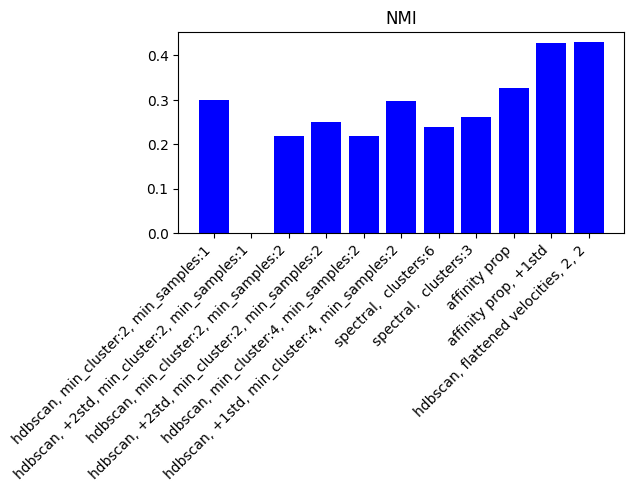

In [119]:
sim_scores = get_clustering_similarity_true(true_labels, clustering_results, sklearn.metrics.normalized_mutual_info_score)
plt.bar(clustering_names, sim_scores, color='blue')
plt.xticks(rotation=45, ha='right') 

plt.tight_layout()

plt.title("NMI")